## We're going to create some heatmaps using holoviews

/Users/frandsenp/miniconda3/lib/python3.5/site-packages/bokeh/util/deprecation.py:34: BokehDeprecationWarning: 
The bokeh.charts API has moved to a separate 'bkcharts' package.

This compatibility shim will remain until Bokeh 1.0 is released.
After that, if you want to use this API you will have to install
the bkcharts package explicitly.

  warn(message)



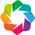

In [1]:
import numpy as np
import holoviews as hv
import pandas as pd
from bokeh.charts import output_notebook, show, HeatMap, output_file
hv.extension('bokeh')

Let's first look at the bacteria counts

In [2]:
df = pd.read_csv("stats_bacteria.csv")

Let's take a look at the data frame to see what the data look like

In [3]:
df

,Phylum,p0001,p0002,p0003,p0004,p0005,p0006,p0007,p0008,p0009,...,p4033,p4034,p4035,p4036,p4037,p4038,p4039,p4040,p4041,p4042
0,Aenigmarchaeota,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Crenarchaeota,1,0,0,0,1,1,0,9,2,...,0,0,0,1,0,0,0,0,0,0
2,Diapherotrites,0,0,0,0,1,0,0,1,1,...,0,0,0,1,0,0,0,0,0,0
3,Euryarchaeota,0,0,0,0,22,24,0,13,7,...,0,0,0,2,0,0,0,0,0,0
4,Korarchaeota,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,Lokiarchaeaota,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,Nanoarchaeota,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
7,Nanohaloarchaeota,0,0,0,0,3,0,0,1,1,...,0,0,0,0,0,0,0,0,0,0
8,Parvarchaeota,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
9,Thaumarchaeota,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
#df = df[df.columns[:50]]

In [ ]:
#df

We need to get the data frame in the right type of format for holoviews

In [4]:
df_resorted = pd.melt(df, id_vars=['Phylum'], var_name='Locus', value_name='Number')

In [5]:
df_resorted = df_resorted[['Locus','Phylum','Number']]

Now create the heatmap

In [6]:
%%opts HeatMap.A [width=5000, height=300]
hm = hv.HeatMap(df_resorted, group='A')

In [ ]:
#hm_opts = dict(width=4050, height=250, tools=['hover'], logz=True, invert_yaxis=True,
            xrotation=90, labelled=[], toolbar='above', xaxis=None)

In [ ]:
#opts = {'HeatMap': {'plot': hm_opts}}

Plot it

In [7]:
plot_opts = dict(width=5000, height=300, xrotation=45, xaxis='top', labelled=[], tools=['hover'])
hm(plot=plot_opts)

:HeatMap   [Locus,Phylum]   (Number)

Let's try a couple of different colors

In [ ]:
style = dict(cmap="GnBu")
hm(style=style)

In [ ]:
style = dict(cmap="Blues")
hm(style=style)

Counts don't seem to be very easy to read, let's try fractions

In [8]:
df2 = pd.read_csv("stats_bacteria_fraction.csv")

In [9]:
df2

,Phylum,p0001,p0002,p0003,p0004,p0005,p0006,p0007,p0008,p0009,...,p4033,p4034,p4035,p4036,p4037,p4038,p4039,p4040,p4041,p4042
0,Aenigmarchaeota,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,Crenarchaeota,0.026316,0.000000,0.000000,0.000000,0.026316,0.026316,0.000000,0.236842,0.052632,...,0.000000,0.000000,0.000000,0.026316,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,Diapherotrites,0.000000,0.000000,0.000000,0.000000,0.500000,0.000000,0.000000,0.500000,0.500000,...,0.000000,0.000000,0.000000,0.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,Euryarchaeota,0.000000,0.000000,0.000000,0.000000,0.203704,0.222222,0.000000,0.120370,0.064815,...,0.000000,0.000000,0.000000,0.018519,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,Korarchaeota,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,Lokiarchaeaota,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,Nanoarchaeota,0.000000,0.000000,0.000000,0.000000,0.500000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,Nanohaloarchaeota,0.000000,0.000000,0.000000,0.000000,0.750000,0.000000,0.000000,0.250000,0.250000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
8,Parvarchaeota,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
9,Thaumarchaeota,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [10]:
df2_resorted = pd.melt(df2, id_vars=['Phylum'], var_name='Locus', value_name='Number')

In [11]:
df2_resorted = df2_resorted[['Locus','Phylum','Number']]

In [12]:
%%opts HeatMap.A [width=5000, height=600, tools=['hover']]
hm2 = hv.HeatMap(df2_resorted, group='A')

Let's plot it.

In [13]:
hm2

:HeatMap   [Locus,Phylum]   (Number)

Ok, let's try a couple of different colors

In [ ]:
style = dict(cmap="GnBu")
hm2(style=style)

In [ ]:
style = dict(cmap="Blues")
hm2(style=style)

If you want to make it work in bokeh, the only way I could get it to do it in a reasonable amount of time was by creating a dictionary from the data frame, don't ask me why that worked!

In [ ]:
#weird_dict = {"Locus": df2_resorted["Locus"].tolist(), "Phylum": df2_resorted["Phylum"].tolist(), "The_numbers": df2_resorted["Number"].tolist()}
#weird_dict

In [ ]:
#hm3 = HeatMap(weird_dict, stat=None, width=10000, legend=None)

In [ ]:
#output_notebook()

In [ ]:
#show(hm3)

### Yeast dataset
Ok, we looked at the bacteria dataset, now let's check out the yeast

In [14]:
df3 = pd.read_csv("001136_fraction.csv")

In [15]:
df3

,PHYLUM,p100,p101,p102,p103,p104,p105,p106,p107,p108,...,p920,p92,p93,p94,p95,p96,p97,p98,p99,p9
0,Aenigmarchaeota,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,Crenarchaeota,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.236842,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,Diapherotrites,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,Euryarchaeota,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.111111,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,Korarchaeota,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,Lokiarchaeaota,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,Nanoarchaeota,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,Nanohaloarchaeota,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
8,Parvarchaeota,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
9,Thaumarchaeota,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [16]:
df3_resorted = pd.melt(df3, id_vars=['PHYLUM'], var_name='Locus', value_name='Number')
df3_resorted = df3_resorted[['Locus','PHYLUM','Number']]
df3_resorted

,Locus,PHYLUM,Number
0,p100,Aenigmarchaeota,0.000000
1,p100,Crenarchaeota,0.000000
2,p100,Diapherotrites,0.000000
3,p100,Euryarchaeota,0.000000
4,p100,Korarchaeota,0.000000
5,p100,Lokiarchaeaota,0.000000
6,p100,Nanoarchaeota,0.000000
7,p100,Nanohaloarchaeota,0.000000
8,p100,Parvarchaeota,0.000000
9,p100,Thaumarchaeota,0.000000


In [17]:
%%opts HeatMap.A [width=5000, height=600, tools=['hover']]
hm3 = hv.HeatMap(df3_resorted, group='A')

In [18]:
hm3

:HeatMap   [Locus,PHYLUM]   (Number)

This time we'll do some data munging to sort the data frame, first by column, then by row. The next few cells add a column, which holds the totals, then sorts the rows by the totals.

In [19]:
includingtotals = pd.concat([df3,pd.DataFrame(df3.sum(axis=1),columns=['Total'])],axis=1)
the_sorted = includingtotals.sort_values(by=['Total'], ascending=[False])

In [20]:
the_sorted

,PHYLUM,p100,p101,p102,p103,p104,p105,p106,p107,p108,...,p92,p93,p94,p95,p96,p97,p98,p99,p9,Total
76,Neocallimastigomycota,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,1.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,160.000000
66,Glomeromycota,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,...,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,160.000000
77,Oomycota,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,132.000000
84,Priapulida,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,123.000000
88,Zygomycota,0.162162,0.135135,0.027027,0.000000,0.594595,0.000000,0.675676,0.000000,0.000000,...,0.000000,0.162162,0.000000,0.000000,0.135135,0.000000,0.189189,0.000000,0.081081,111.594595
40,Annelida,0.000000,0.500000,0.000000,0.000000,0.000000,0.000000,0.500000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.500000,0.000000,0.000000,110.500000
44,Ascomycota,0.156371,0.144788,0.160232,0.054054,0.521236,0.071429,0.378378,0.063707,0.108108,...,0.021236,0.252896,0.038610,0.061776,0.229730,0.083012,0.100386,0.036680,0.202703,101.638996
57,Cryptomycota,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,99.000000
61,Dinoflagellata,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,99.000000
62,Echinodermata,0.111111,0.222222,0.000000,0.000000,0.555556,0.000000,0.444444,0.000000,0.000000,...,0.000000,0.111111,0.000000,0.000000,0.000000,0.111111,0.222222,0.000000,0.000000,98.333333


In [21]:
df4 = the_sorted

In [22]:
del df4['Total']

In [23]:
df4

,PHYLUM,p100,p101,p102,p103,p104,p105,p106,p107,p108,...,p920,p92,p93,p94,p95,p96,p97,p98,p99,p9
76,Neocallimastigomycota,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,1.000000,0.000000,...,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
66,Glomeromycota,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,...,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
77,Oomycota,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
84,Priapulida,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,...,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
88,Zygomycota,0.162162,0.135135,0.027027,0.000000,0.594595,0.000000,0.675676,0.000000,0.000000,...,0.162162,0.000000,0.162162,0.000000,0.000000,0.135135,0.000000,0.189189,0.000000,0.081081
40,Annelida,0.000000,0.500000,0.000000,0.000000,0.000000,0.000000,0.500000,0.000000,0.000000,...,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.500000,0.000000,0.000000
44,Ascomycota,0.156371,0.144788,0.160232,0.054054,0.521236,0.071429,0.378378,0.063707,0.108108,...,0.183398,0.021236,0.252896,0.038610,0.061776,0.229730,0.083012,0.100386,0.036680,0.202703
57,Cryptomycota,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
61,Dinoflagellata,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,...,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
62,Echinodermata,0.111111,0.222222,0.000000,0.000000,0.555556,0.000000,0.444444,0.000000,0.000000,...,0.555556,0.000000,0.111111,0.000000,0.000000,0.000000,0.111111,0.222222,0.000000,0.000000


Now we'll take a look at the heatmap

In [24]:
df4_resorted = pd.melt(df4, id_vars=['PHYLUM'], var_name='Locus', value_name='Number')
df4_resorted = df4_resorted[['Locus','PHYLUM','Number']]
df4_resorted

,Locus,PHYLUM,Number
0,p100,Neocallimastigomycota,0.000000
1,p100,Glomeromycota,1.000000
2,p100,Oomycota,0.000000
3,p100,Priapulida,1.000000
4,p100,Zygomycota,0.162162
5,p100,Annelida,0.000000
6,p100,Ascomycota,0.156371
7,p100,Cryptomycota,0.000000
8,p100,Dinoflagellata,0.000000
9,p100,Echinodermata,0.111111


In [25]:
%%opts HeatMap.A [width=5000, height=600, tools=['hover']]
hm4 = hv.HeatMap(df4_resorted, group='A')

In [26]:
hm4

:HeatMap   [Locus,PHYLUM]   (Number)

Now we're going to sort the columns by the totals

In [27]:
df4

,PHYLUM,p100,p101,p102,p103,p104,p105,p106,p107,p108,...,p920,p92,p93,p94,p95,p96,p97,p98,p99,p9
76,Neocallimastigomycota,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,1.000000,0.000000,...,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
66,Glomeromycota,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,...,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
77,Oomycota,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
84,Priapulida,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,...,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
88,Zygomycota,0.162162,0.135135,0.027027,0.000000,0.594595,0.000000,0.675676,0.000000,0.000000,...,0.162162,0.000000,0.162162,0.000000,0.000000,0.135135,0.000000,0.189189,0.000000,0.081081
40,Annelida,0.000000,0.500000,0.000000,0.000000,0.000000,0.000000,0.500000,0.000000,0.000000,...,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.500000,0.000000,0.000000
44,Ascomycota,0.156371,0.144788,0.160232,0.054054,0.521236,0.071429,0.378378,0.063707,0.108108,...,0.183398,0.021236,0.252896,0.038610,0.061776,0.229730,0.083012,0.100386,0.036680,0.202703
57,Cryptomycota,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
61,Dinoflagellata,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,...,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
62,Echinodermata,0.111111,0.222222,0.000000,0.000000,0.555556,0.000000,0.444444,0.000000,0.000000,...,0.555556,0.000000,0.111111,0.000000,0.000000,0.000000,0.111111,0.222222,0.000000,0.000000


In [28]:
total = df4.apply(np.sum)
total['PHYLUM'] = 'total'
df5 = df4.append(pd.DataFrame(total.values, index=total.keys()).T, ignore_index=True)

Take a look to see if it worked

In [29]:
df5

,PHYLUM,p100,p101,p102,p103,p104,p105,p106,p107,p108,...,p920,p92,p93,p94,p95,p96,p97,p98,p99,p9
0,Neocallimastigomycota,0,0,0,0,1,0,1,1,0,...,1,0,0,0,0,0,0,0,0,0
1,Glomeromycota,1,0,0,1,1,0,1,0,0,...,0,0,1,0,0,0,0,0,0,0
2,Oomycota,0,0,0,0,0,0,0,0,0,...,1,0,1,0,0,0,0,0,0,0
3,Priapulida,1,0,0,0,0,0,1,0,0,...,1,0,0,0,0,0,0,0,0,0
4,Zygomycota,0.162162,0.135135,0.027027,0,0.594595,0,0.675676,0,0,...,0.162162,0,0.162162,0,0,0.135135,0,0.189189,0,0.0810811
5,Annelida,0,0.5,0,0,0,0,0.5,0,0,...,1,0,0,0,0,0,0,0.5,0,0
6,Ascomycota,0.156371,0.144788,0.160232,0.0540541,0.521236,0.0714286,0.378378,0.0637066,0.108108,...,0.183398,0.0212355,0.252896,0.03861,0.0617761,0.22973,0.0830116,0.100386,0.0366795,0.202703
7,Cryptomycota,0,0,0,0,1,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
8,Dinoflagellata,0,0,0,0,0,0,1,0,0,...,1,0,0,0,0,0,0,0,0,0
9,Echinodermata,0.111111,0.222222,0,0,0.555556,0,0.444444,0,0,...,0.555556,0,0.111111,0,0,0,0.111111,0.222222,0,0


In [30]:
df6 = df5

Since we're going to need to sort columns by a numerical total, let's get rid of the Phylum column, which contains strings, evidently, df6 is just a reference to the df5 data frame so be careful because it also deletes the category from df5

In [31]:
del df6["PHYLUM"]

In [32]:
df6

,p100,p101,p102,p103,p104,p105,p106,p107,p108,p109,...,p920,p92,p93,p94,p95,p96,p97,p98,p99,p9
0,0,0,0,0,1,0,1,1,0,1,...,1,0,0,0,0,0,0,0,0,0
1,1,0,0,1,1,0,1,0,0,1,...,0,0,1,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,2,...,1,0,1,0,0,0,0,0,0,0
3,1,0,0,0,0,0,1,0,0,1,...,1,0,0,0,0,0,0,0,0,0
4,0.162162,0.135135,0.027027,0,0.594595,0,0.675676,0,0,0.810811,...,0.162162,0,0.162162,0,0,0.135135,0,0.189189,0,0.0810811
5,0,0.5,0,0,0,0,0.5,0,0,1,...,1,0,0,0,0,0,0,0.5,0,0
6,0.156371,0.144788,0.160232,0.0540541,0.521236,0.0714286,0.378378,0.0637066,0.108108,0.754826,...,0.183398,0.0212355,0.252896,0.03861,0.0617761,0.22973,0.0830116,0.100386,0.0366795,0.202703
7,0,0,0,0,1,0,1,0,0,1,...,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,1,0,0,1,...,1,0,0,0,0,0,0,0,0,0
9,0.111111,0.222222,0,0,0.555556,0,0.444444,0,0,0.666667,...,0.555556,0,0.111111,0,0,0,0.111111,0.222222,0,0


Sort the columns in descending order by the values in the total row

In [33]:
new_columns = df6.sort_values(df6.last_valid_index(), axis=1, ascending=False)

Check it out to make sure that it worked

In [34]:
new_columns

,p127,p109,p764,p68,p81,p381,p579,p252,p873,p91,...,p260,p259,p266,p559,p282,p698,p273,p429,p226,p313
0,1,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
1,1,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
2,2,2,2,2,2,2,1,1,2,2,...,0,0,0,0,0,0,0,0,0,0
3,1,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
4,0.864865,0.810811,0.810811,0.756757,0.864865,0.810811,0.756757,0.783784,0.648649,0.810811,...,0,0,0,0,0,0,0,0,0,0
5,0.5,1,0.5,1,0.5,0.5,0,0.5,0.5,1,...,0,0,0,0,0,0,0,0,0,0
6,0.752896,0.754826,0.584942,0.627413,0.72973,0.588803,0.494208,0.581081,0.554054,0.617761,...,0.00579151,0.00579151,0.00772201,0.00772201,0.00772201,0.00579151,0.00579151,0.00579151,0.00579151,0.00579151
7,1,1,1,1,0,1,1,0,1,1,...,0,0,0,0,0,0,0,0,0,0
8,1,1,1,0,1,1,1,0,0,1,...,0,0,0,0,0,0,0,0,0,0
9,0.666667,0.666667,0.555556,0.666667,0.555556,0.666667,0.222222,0.666667,0.555556,0.444444,...,0,0,0,0,0,0,0,0,0,0


Ok, now let's insert the Phylum column back into the data frame.

In [35]:
df5 = df4.append(pd.DataFrame(total.values, index=total.keys()).T, ignore_index=True)
new_columns.insert(0, "PHYLUM", df5["PHYLUM"])

In [36]:
new_columns

,PHYLUM,p127,p109,p764,p68,p81,p381,p579,p252,p873,...,p260,p259,p266,p559,p282,p698,p273,p429,p226,p313
0,Neocallimastigomycota,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
1,Glomeromycota,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
2,Oomycota,2,2,2,2,2,2,1,1,2,...,0,0,0,0,0,0,0,0,0,0
3,Priapulida,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
4,Zygomycota,0.864865,0.810811,0.810811,0.756757,0.864865,0.810811,0.756757,0.783784,0.648649,...,0,0,0,0,0,0,0,0,0,0
5,Annelida,0.5,1,0.5,1,0.5,0.5,0,0.5,0.5,...,0,0,0,0,0,0,0,0,0,0
6,Ascomycota,0.752896,0.754826,0.584942,0.627413,0.72973,0.588803,0.494208,0.581081,0.554054,...,0.00579151,0.00579151,0.00772201,0.00772201,0.00772201,0.00579151,0.00579151,0.00579151,0.00579151,0.00579151
7,Cryptomycota,1,1,1,1,0,1,1,0,1,...,0,0,0,0,0,0,0,0,0,0
8,Dinoflagellata,1,1,1,0,1,1,1,0,0,...,0,0,0,0,0,0,0,0,0,0
9,Echinodermata,0.666667,0.666667,0.555556,0.666667,0.555556,0.666667,0.222222,0.666667,0.555556,...,0,0,0,0,0,0,0,0,0,0


Get rid of the row holding the column sums

In [37]:
df7 = new_columns.drop(89)

Confirm that its gone, then make another heatmap

In [38]:
df7

,PHYLUM,p127,p109,p764,p68,p81,p381,p579,p252,p873,...,p260,p259,p266,p559,p282,p698,p273,p429,p226,p313
0,Neocallimastigomycota,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
1,Glomeromycota,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
2,Oomycota,2,2,2,2,2,2,1,1,2,...,0,0,0,0,0,0,0,0,0,0
3,Priapulida,1,1,1,1,1,1,1,1,1,...,0,0,0,0,0,0,0,0,0,0
4,Zygomycota,0.864865,0.810811,0.810811,0.756757,0.864865,0.810811,0.756757,0.783784,0.648649,...,0,0,0,0,0,0,0,0,0,0
5,Annelida,0.5,1,0.5,1,0.5,0.5,0,0.5,0.5,...,0,0,0,0,0,0,0,0,0,0
6,Ascomycota,0.752896,0.754826,0.584942,0.627413,0.72973,0.588803,0.494208,0.581081,0.554054,...,0.00579151,0.00579151,0.00772201,0.00772201,0.00772201,0.00579151,0.00579151,0.00579151,0.00579151,0.00579151
7,Cryptomycota,1,1,1,1,0,1,1,0,1,...,0,0,0,0,0,0,0,0,0,0
8,Dinoflagellata,1,1,1,0,1,1,1,0,0,...,0,0,0,0,0,0,0,0,0,0
9,Echinodermata,0.666667,0.666667,0.555556,0.666667,0.555556,0.666667,0.222222,0.666667,0.555556,...,0,0,0,0,0,0,0,0,0,0


In [39]:
df7_resorted = pd.melt(df7, id_vars=['PHYLUM'], var_name='Locus', value_name='Number')
df7_resorted = df7_resorted[['Locus', 'PHYLUM', 'Number']]

In [40]:
df7_resorted

,Locus,PHYLUM,Number
0,p127,Neocallimastigomycota,1
1,p127,Glomeromycota,1
2,p127,Oomycota,2
3,p127,Priapulida,1
4,p127,Zygomycota,0.864865
5,p127,Annelida,0.5
6,p127,Ascomycota,0.752896
7,p127,Cryptomycota,1
8,p127,Dinoflagellata,1
9,p127,Echinodermata,0.666667


In [41]:
%%opts HeatMap.A [width=5000, height=600, tools=['hover']]
hm7 = hv.HeatMap(df7_resorted, group='A')

In [42]:
hm7

:HeatMap   [Locus,PHYLUM]   (Number)

And a different look with some different colors

In [43]:
style = dict(cmap="Blues")
hm7(style=style)

:HeatMap   [Locus,PHYLUM]   (Number)